In [ ]:
!pip install osmnx

     |████████████████████████████████| 95 kB 4.0 MB/s 
     |████████████████████████████████| 11.2 MB 65.8 MB/s 
     |████████████████████████████████| 63 kB 1.4 MB/s 
     |████████████████████████████████| 1.0 MB 60.9 MB/s 
     |████████████████████████████████| 1.0 MB 19.6 MB/s 
     |████████████████████████████████| 6.3 MB 60.8 MB/s 
     |████████████████████████████████| 16.7 MB 53.0 MB/s 
     |████████████████████████████████| 900 kB 57.4 MB/s 
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requ

In [ ]:
!pip uninstall matplotlib
!pip install matplotlib==3.1.3

Found existing installation: matplotlib 3.5.1
Uninstalling matplotlib-3.5.1:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/matplotlib-3.5.1-py3.7-nspkg.pth
    /usr/local/lib/python3.7/dist-packages/matplotlib-3.5.1.dist-info/*
    /usr/local/lib/python3.7/dist-packages/matplotlib/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/axes_grid/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/axes_grid1/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/axisartist/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/mplot3d/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/tests/*
    /usr/local/lib/python3.7/dist-packages/pylab.py
Proceed (y/n)? y
  Successfully uninstalled matplotlib-3.5.1
     |████████████████████████████████| 13.1 MB 14.6 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
osmnx 1.1.2 requires

In [ ]:
import osmnx as ox
import matplotlib.pyplot as plt
import geopandas as gpd
import seaborn as sns

%matplotlib inline

In [ ]:
# Select city and crs
cityname = 'warsaw, poland'
crs = 3035

In [ ]:
# Get graph by geocoding
graph = ox.graph_from_place(cityname, network_type="walk")

# Project graph
graph = ox.projection.project_graph(graph, to_crs=crs)

KeyboardInterrupt: ignored

In [ ]:
# Simplify to get real intersections only
# (consolidate nodes within a distance from eachother)
graph_simplified = ox.simplification.consolidate_intersections(
    # Graph to simplify
    graph,
    # buffer around each node (project the graph beforehand)
    tolerance=5,
    # Get result as graph (False to get nodes only as gdf)
    rebuild_graph=True,
    # no dead ends
    dead_ends=False,
    # Reconnect (False to get intersections only)
    reconnect_edges=True
)

In [ ]:
graph

In [ ]:
# everything to gdfs
nodes, edges = ox.graph_to_gdfs(graph)
nodes_s, edges_s = ox.graph_to_gdfs(graph_simplified)

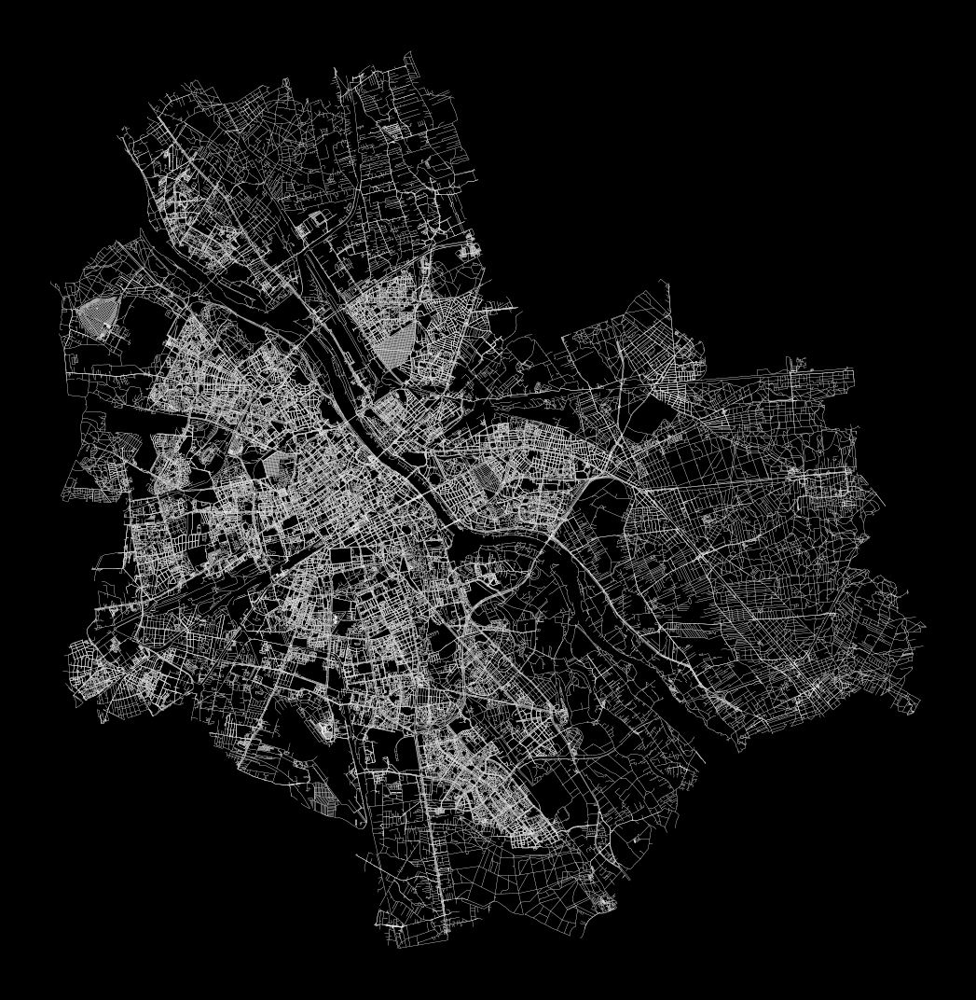

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot data
edges.plot(
    ax=ax,
    color='white',
    linewidth=0.2
)

# Tight layout
plt.tight_layout()

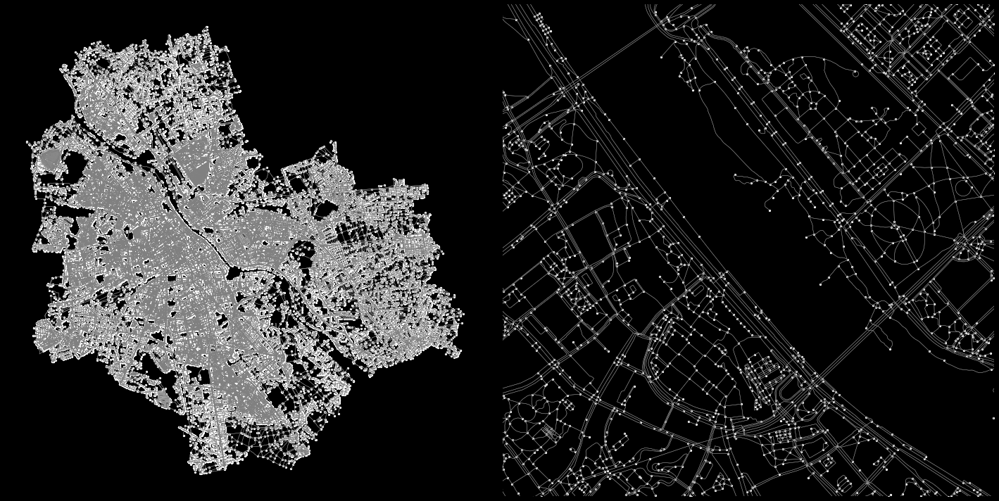

In [ ]:
# Define colors
edgecol = [0.5,0.5,0.5]
nodecol = 'white'
linewidth = 0.5
markersize = 5

# Setup plot
fig, ax = plt.subplots(ncols=2, figsize=(20,10))
ax[0].set_axis_off()
ax[1].set_axis_off()
ax[0].set_aspect('equal')
ax[1].set_aspect('equal')
fig.set_facecolor('black')

# Plot original graph
edges.plot(ax=ax[0], color=edgecol, linewidth=linewidth)
nodes.plot(ax=ax[0], color=nodecol, markersize=markersize)

# Plot simplified graph
edges_s.plot(ax=ax[1], color=edgecol, linewidth=linewidth)
nodes_s.plot(ax=ax[1], color=nodecol, markersize=markersize)

# Zoom in
# plt.setp(ax[0], xlim=(5069000,5071000), ylim=(3294000,3296000))
plt.setp(ax[1], xlim=(5069000,5071000), ylim=(3294000,3296000))

# Tight layout 
plt.tight_layout()


In [ ]:
# Select city and crs
sf = 'san francisco, usa'
crs = 4326

In [ ]:
# Get graph by geocoding
graph_sf = ox.graph_from_place(sf, network_type="walk")

# Project graph
graph_sf = ox.projection.project_graph(graph_sf, to_crs=crs)

In [ ]:
# Simplify to get real intersections only
# (consolidate nodes within a distance from eachother)
graph_simplified_sf = ox.simplification.consolidate_intersections(
    # Graph to simplify
    graph_sf,
    # buffer around each node (project the graph beforehand)
    tolerance=5,
    # Get result as graph (False to get nodes only as gdf)
    rebuild_graph=True,
    # no dead ends
    dead_ends=False,
    # Reconnect (False to get intersections only)
    reconnect_edges=True
)

/usr/local/lib/python3.7/dist-packages/osmnx/simplification.py:424: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/usr/local/lib/python3.7/dist-packages/osmnx/simplification.py:472: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = node_clusters.centroid


In [ ]:
# everything to gdfs
nodes_sf, edges_sf = ox.graph_to_gdfs(graph_sf)
nodes_s_sf, edges_s_sf = ox.graph_to_gdfs(graph_simplified_sf)

In [ ]:
nodes_sf.head()
nodes_sf.to_csv('/content/nodes_sf.csv') 

In [ ]:
nodes_s_sf.head()

,osmid_original,x,y,street_count,geometry
osmid,,,,,
0,"[33241803, 2071244747, 2071244838, 2071244784,...",-122.441443,37.753731,0,POINT (-122.44144 37.75373)


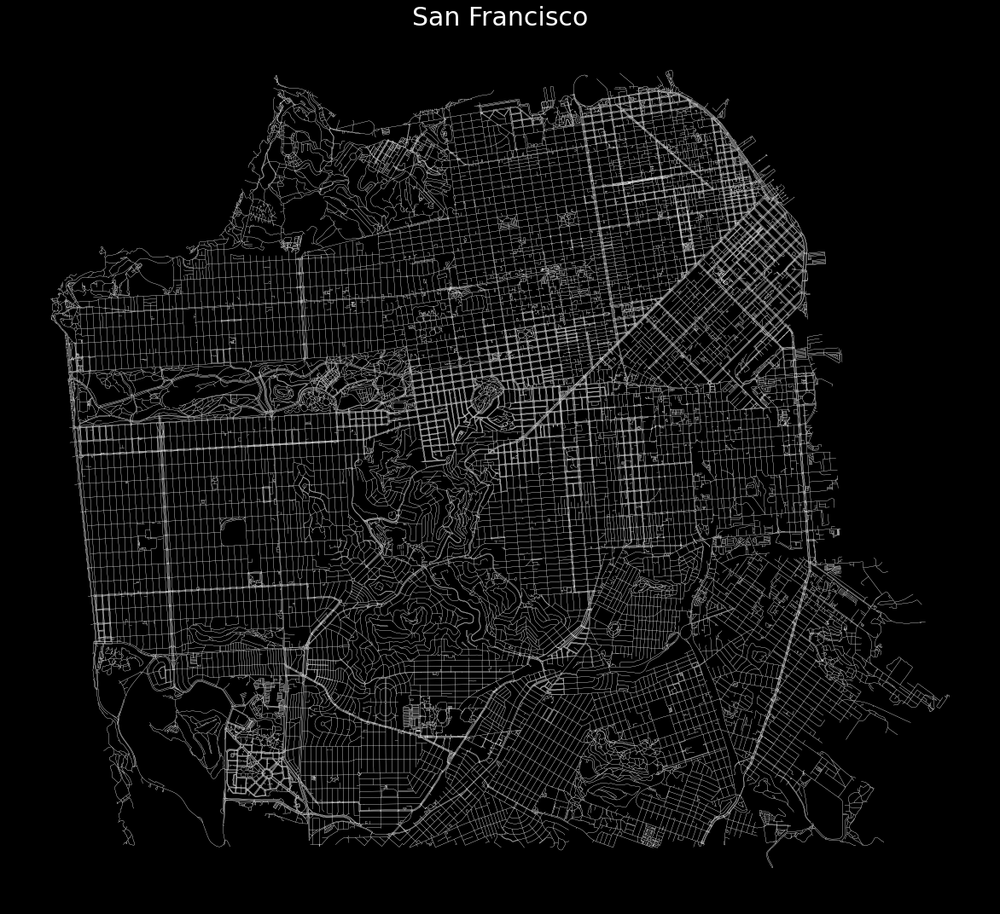

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot data
edges_sf.plot(
    ax=ax,
    color='white',
    linewidth=0.2
)
plt.title("San Francisco", fontsize=30, color="white")

# Tight layout
plt.tight_layout()
# Save
fig.savefig('/content/SF_Street.png', facecolor=fig.get_facecolor())

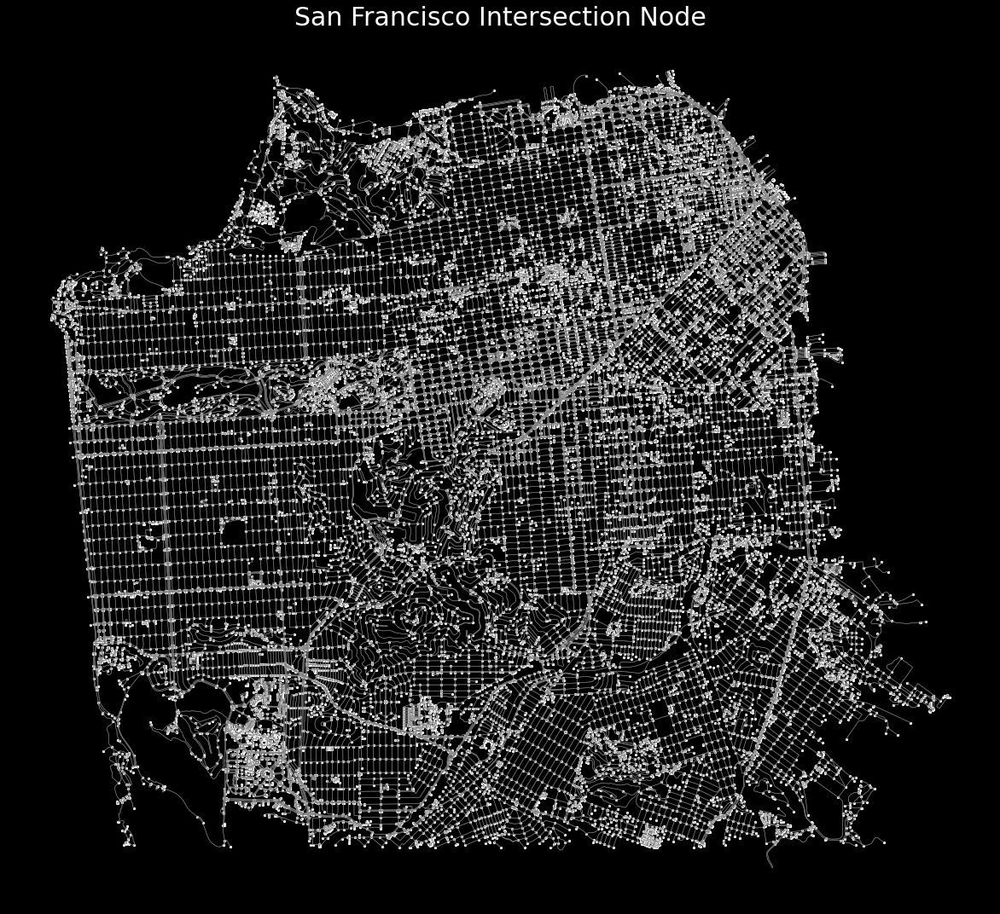

In [ ]:
# Define colors
edgecol = [0.5,0.5,0.5]
nodecol = 'white'
linewidth = 0.5
markersize = 5

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot original graph
edges_sf.plot(ax=ax, color=edgecol, linewidth=linewidth)
nodes_sf.plot(ax=ax, color=nodecol, markersize=markersize)

plt.title("San Francisco Intersection Node", fontsize=30, color="white")

# Plot simplified graph
# edges_s.plot(ax=ax[1], color=edgecol, linewidth=linewidth)
# nodes_s.plot(ax=ax[1], color=nodecol, markersize=markersize)

# Zoom in
# plt.setp(ax[0], xlim=(5069000,5071000), ylim=(3294000,3296000))
#plt.setp(ax[1], xlim=(5069000,5071000), ylim=(3294000,3296000))

# Tight layout 
plt.tight_layout()
# Save
plt.savefig('/content/SF_Node.png', facecolor=fig.get_facecolor())

In [ ]:
# Print info
print(
    'number of nodes:\n\noriginal graph: '+str(len(nodes_sf))
    +'\nsimplified graph: '+str(len(nodes_s_sf))
)

number of nodes:

original graph: 39115
simplified graph: 1


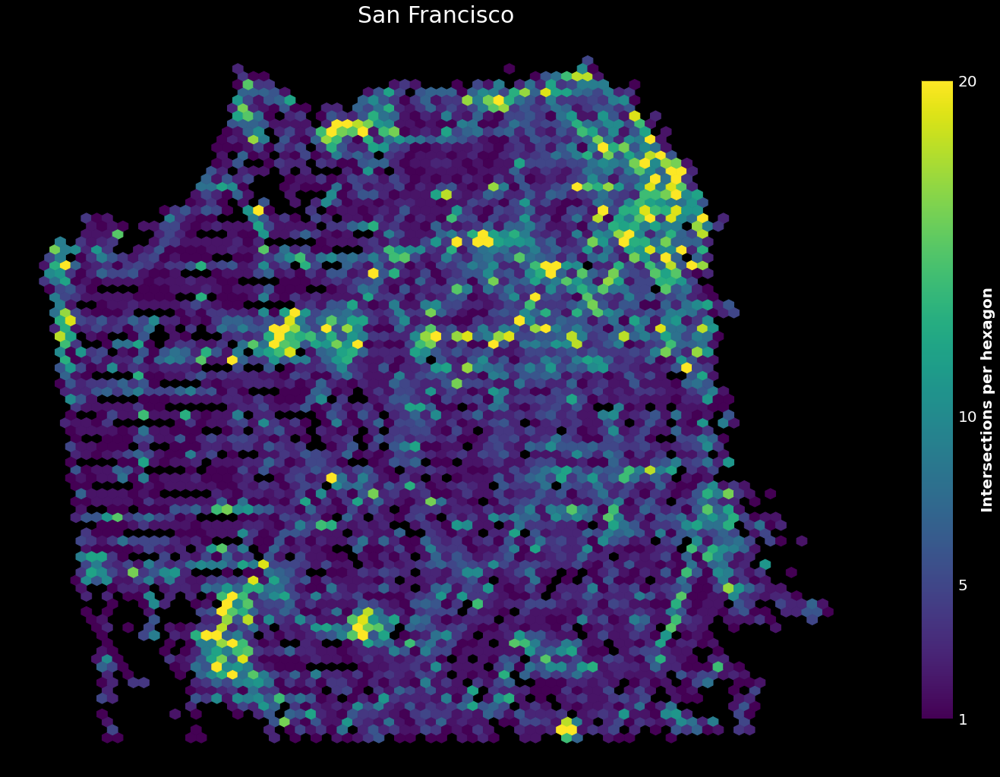

In [ ]:
# Set all text color to white
COLOR = 'white'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot as hexbins
hb = ax.hexbin(
    x=nodes_s_sf['x'],
    y=nodes_s_sf['y'],
    gridsize=75,
    cmap='viridis',
    mincnt=1,
    vmax=20,
)

plt.title("San Francisco", fontsize=30, color="white")
# Colorbar
cb = plt.colorbar(hb, ax=ax, shrink=0.8, ticks=[1, 5, 10, 20, 40, 50])
cb.ax.tick_params(color='none', labelsize=20)
cb.ax.set_yticklabels(['1', '5', '10', '20', '40', '>= 40'])
cb.set_label('Intersections per hexagon', fontsize=20, fontweight='bold')

# Tight layout
plt.tight_layout()

fig.savefig('/content/SF_Hex.png', facecolor=fig.get_facecolor())


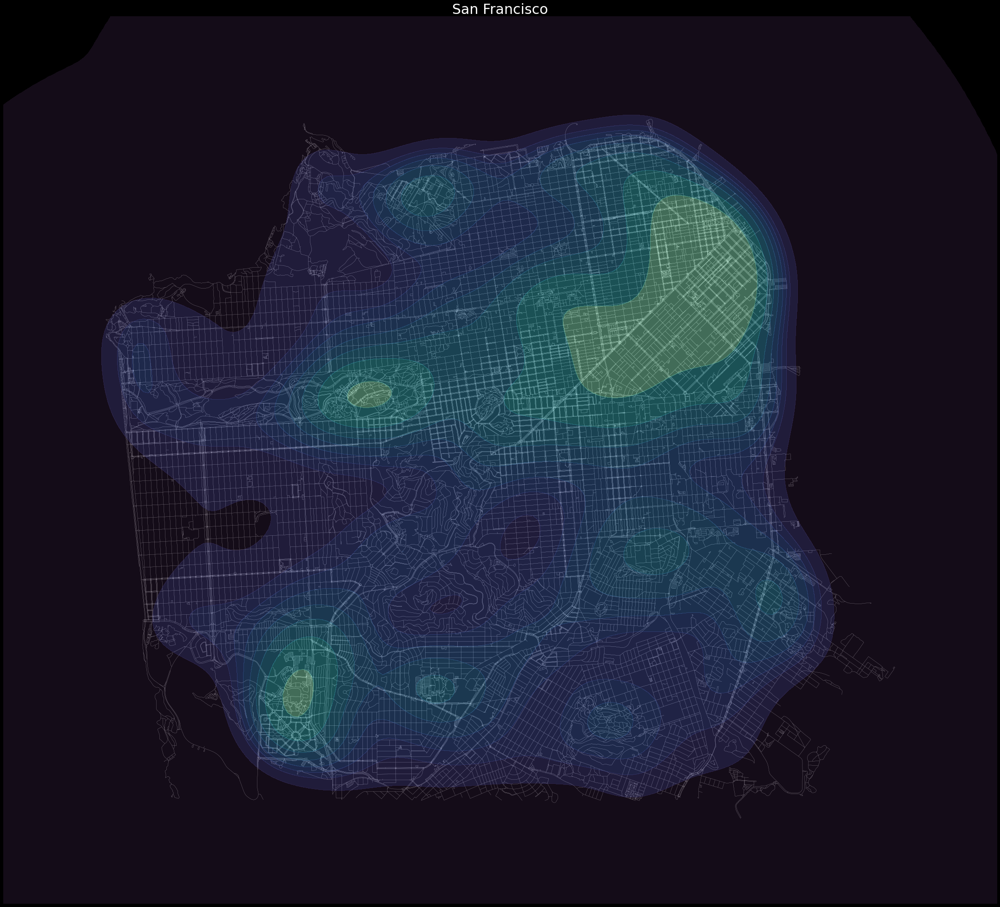

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(30,30))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot streets underneath
edges_s.plot(ax=ax, color=[1,1,1], linewidth=0.2, zorder= 0)

# Plot KDE on top
sns.kdeplot(
    ax=ax,
    data=nodes_s,
    x='x', y='y',
    hue=None,
    fill=True,
    cmap='mako',
    thresh=0,
    levels=10,
    alpha=0.5,
    zorder=10
)

plt.title("San Francisco", fontsize=30, color="white")
# Tight layout
plt.tight_layout()

# Save
plt.savefig('/content/SF_intersection_kde.png', bbox_inches='tight', facecolor=fig.get_facecolor())


In [ ]:
# Select city and crs
ny = 'new york city, usa'
crs_ny = 3624

In [ ]:
# Get graph by geocoding
graph_ny = ox.graph_from_place(ny, network_type="walk")

# Project graph
graph_ny = ox.projection.project_graph(graph_ny, to_crs=crs_ny)

In [ ]:
# Simplify to get real intersections only
# (consolidate nodes within a distance from eachother)
graph_simplified_ny = ox.simplification.consolidate_intersections(
    # Graph to simplify
    graph_ny,
    # buffer around each node (project the graph beforehand)
    tolerance=5,
    # Get result as graph (False to get nodes only as gdf)
    rebuild_graph=True,
    # no dead ends
    dead_ends=False,
    # Reconnect (False to get intersections only)
    reconnect_edges=True
)

In [ ]:
# everything to gdfs
nodes_ny, edges = ox.graph_to_gdfs(graph_ny)
nodes_s_ny, edges_s = ox.graph_to_gdfs(graph_simplified_ny)

In [ ]:
nodes_ny.head()
nodes_ny.to_csv('/content/nodes_ny.csv') 

In [ ]:
nodes_ny

,y,x,street_count,lon,lat,highway,ref,geometry
osmid,,,,,,,,
30807314,298888.729183,1.545624e+06,4,-73.963576,40.790720,NaN,NaN,POINT (1545623.679 298888.729)
4332491202,298918.603697,1.545595e+06,4,-73.963678,40.790805,NaN,NaN,POINT (1545594.597 298918.604)
2057103273,298401.354134,1.545568e+06,4,-73.963831,40.789389,NaN,NaN,POINT (1545567.677 298401.354)
6579409036,299007.199455,1.545773e+06,3,-73.963025,40.791033,NaN,NaN,POINT (1545773.084 299007.199)
1203806263,298864.239388,1.545712e+06,3,-73.963260,40.790646,NaN,NaN,POINT (1545712.111 298864.239)
...,...,...,...,...,...,...,...,...
9670269832,261072.422450,1.559792e+06,1,-73.916609,40.685858,NaN,NaN,POINT (1559791.705 261072.422)
9670966966,288882.793132,1.583076e+06,1,-73.829602,40.760138,NaN,NaN,POINT (1583075.659 288882.793)
9671139556,288981.440990,1.583144e+06,3,-73.829345,40.760403,NaN,NaN,POINT (1583143.781 288981.441)


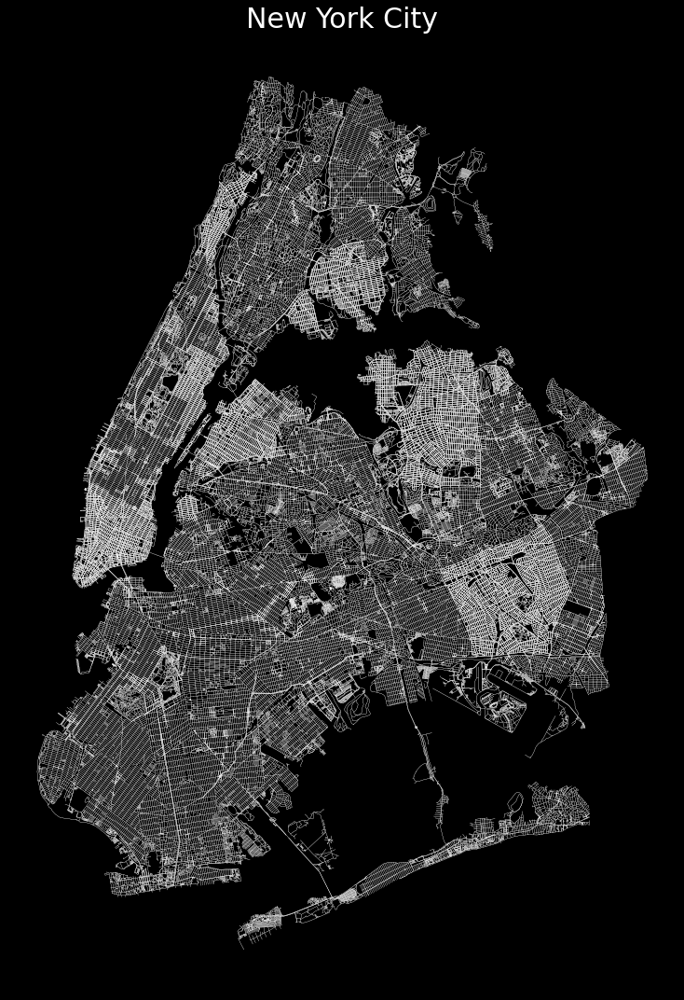

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot data
edges.plot(
    ax=ax,
    color='white',
    linewidth=0.2
)
plt.title("New York City", fontsize=30, color="white")

# Tight layout
plt.tight_layout()
# Save
fig.savefig('/content/NY_Street.png', facecolor=fig.get_facecolor())

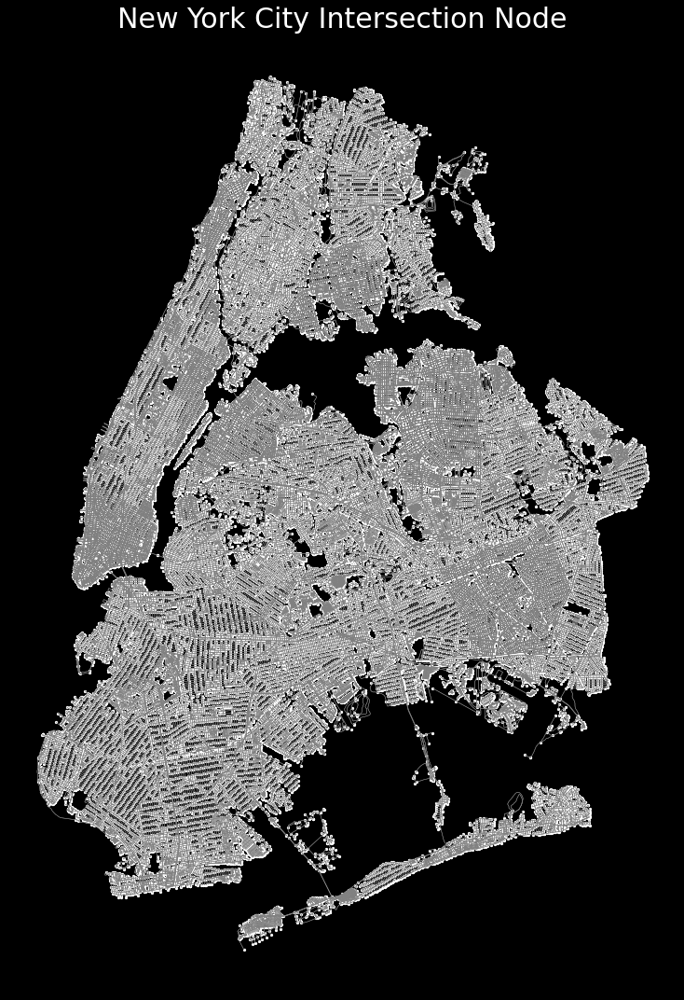

In [ ]:
# Define colors
edgecol = [0.5,0.5,0.5]
nodecol = 'white'
linewidth = 0.5
markersize = 5

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot original graph
edges.plot(ax=ax, color=edgecol, linewidth=linewidth)
nodes.plot(ax=ax, color=nodecol, markersize=markersize)

plt.title("New York City Intersection Node", fontsize=30, color="white")


# Tight layout 
plt.tight_layout()
# Save
plt.savefig('/content/NYC_Node.png', facecolor=fig.get_facecolor())

In [ ]:
# Print info
print(
    'number of nodes:\n\noriginal graph: '+str(len(nodes))
)

number of nodes:

original graph: 178811


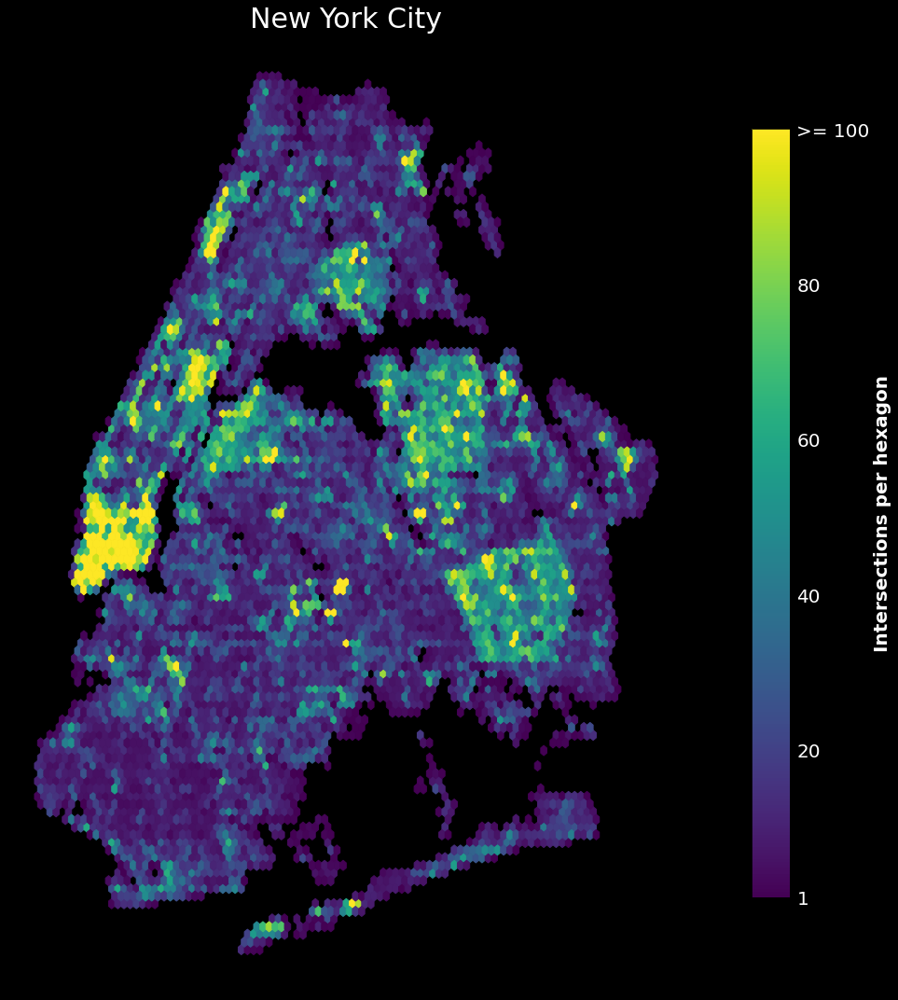

In [ ]:
# Set all text color to white
COLOR = 'white'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot as hexbins
hb = ax.hexbin(
    x=nodes_s['x'],
    y=nodes_s['y'],
    gridsize=100,
    cmap='viridis',
    mincnt=1,
    vmax=100,
)

plt.title("New York City", fontsize=30, color="white")
# Colorbar
cb = plt.colorbar(hb, ax=ax, shrink=0.8, ticks=[1, 20, 40, 60, 80, 100])
cb.ax.tick_params(color='none', labelsize=20)
cb.ax.set_yticklabels(['1', '20', '40', '60', '80', '>= 100'])
cb.set_label('Intersections per hexagon', fontsize=20, fontweight='bold')

# Tight layout
plt.tight_layout()

fig.savefig('/content/NYC_Hex.png', facecolor=fig.get_facecolor())


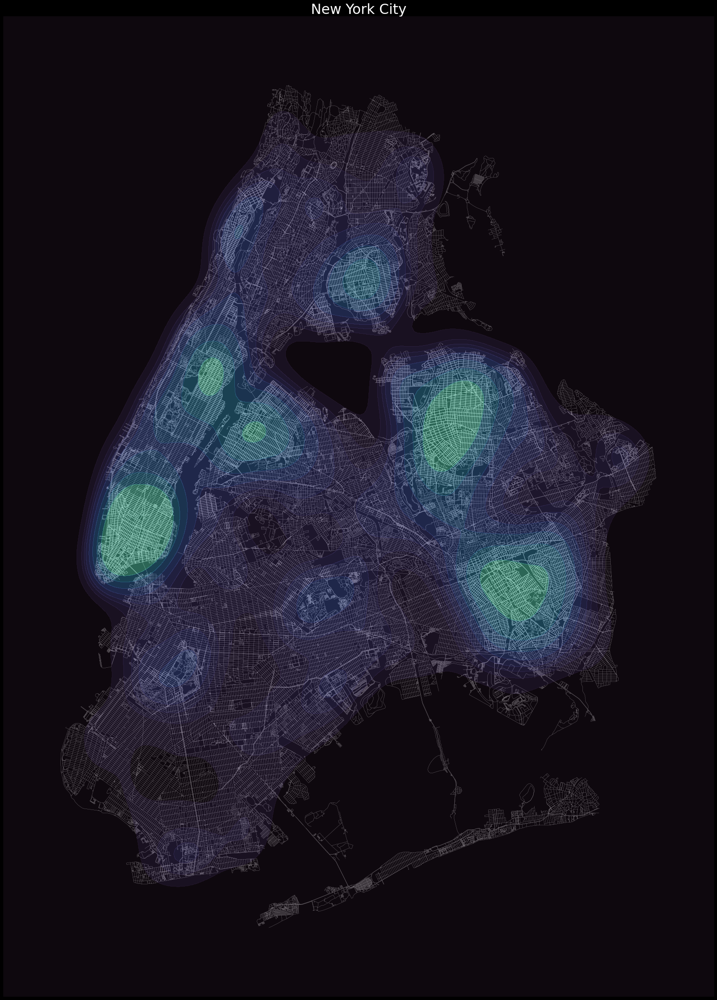

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(30,30))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot streets underneath
edges_s.plot(ax=ax, color=[1,1,1], linewidth=0.2, zorder= 0)

# Plot KDE on top
sns.kdeplot(
    ax=ax,
    data=nodes_s,
    x='x', y='y',
    hue=None,
    fill=True,
    cmap='mako',
    thresh=0,
    levels=10,
    alpha=0.5,
    zorder=10
)

plt.title("New York City", fontsize=30, color="white")
# Tight layout
plt.tight_layout()

# Save
plt.savefig('/content/NYC_intersection_kde.png', bbox_inches='tight', facecolor=fig.get_facecolor())

In [ ]:
# Select city and crs
dc = 'washington dc, usa'
crs_dc = 4269

In [ ]:
# Get graph by geocoding
graph_dc = ox.graph_from_place(dc, network_type="walk")

# Project graph
graph_dc = ox.projection.project_graph(graph_dc, to_crs=crs_dc)

In [ ]:
# Simplify to get real intersections only
# (consolidate nodes within a distance from eachother)
graph_simplified_dc = ox.simplification.consolidate_intersections(
    # Graph to simplify
    graph_dc,
    # buffer around each node (project the graph beforehand)
    tolerance=5,
    # Get result as graph (False to get nodes only as gdf)
    rebuild_graph=True,
    # no dead ends
    dead_ends=False,
    # Reconnect (False to get intersections only)
    reconnect_edges=True
)

/usr/local/lib/python3.7/dist-packages/osmnx/simplification.py:424: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/usr/local/lib/python3.7/dist-packages/osmnx/simplification.py:472: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = node_clusters.centroid


In [ ]:
# everything to gdfs
nodes_dc, edges = ox.graph_to_gdfs(graph_dc)
nodes_s_dc, edges_s = ox.graph_to_gdfs(graph_simplified_dc)


In [ ]:
nodes_dc.head()
nodes_dc.to_csv('/content/nodes_dc.csv') 

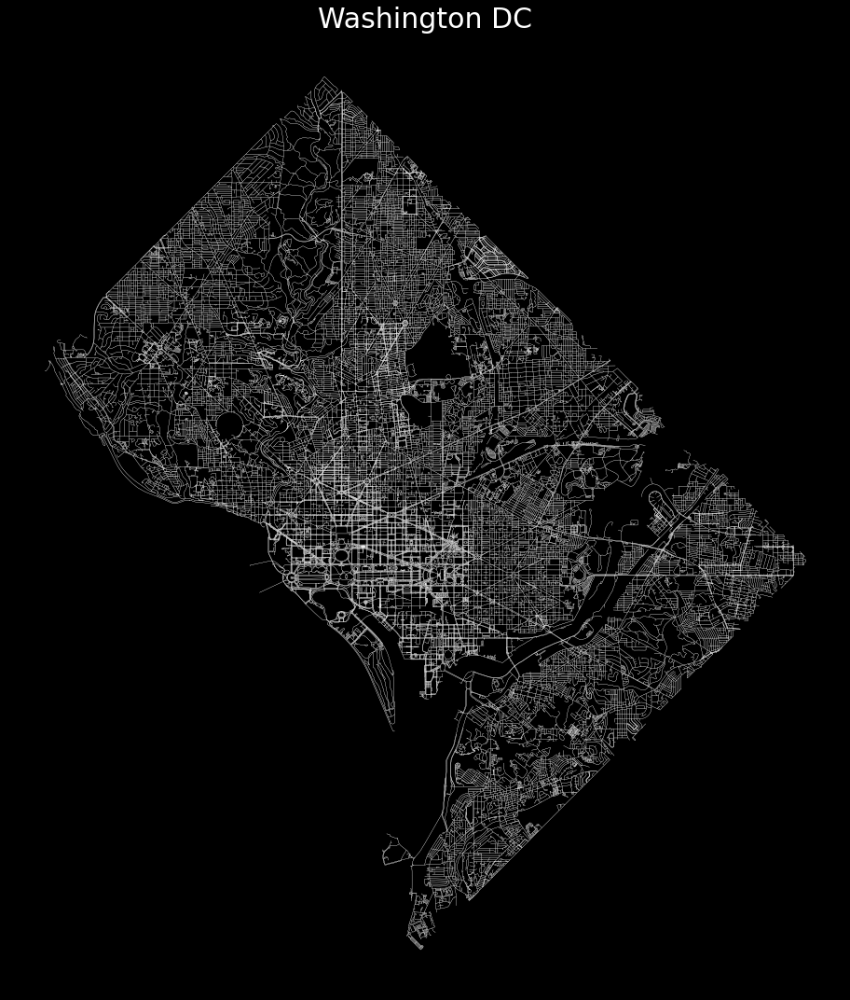

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot data
edges.plot(
    ax=ax,
    color='white',
    linewidth=0.2
)
plt.title("Washington DC", fontsize=30, color="white")

# Tight layout
plt.tight_layout()
# Save
fig.savefig('/content/DC_Street.png', facecolor=fig.get_facecolor())

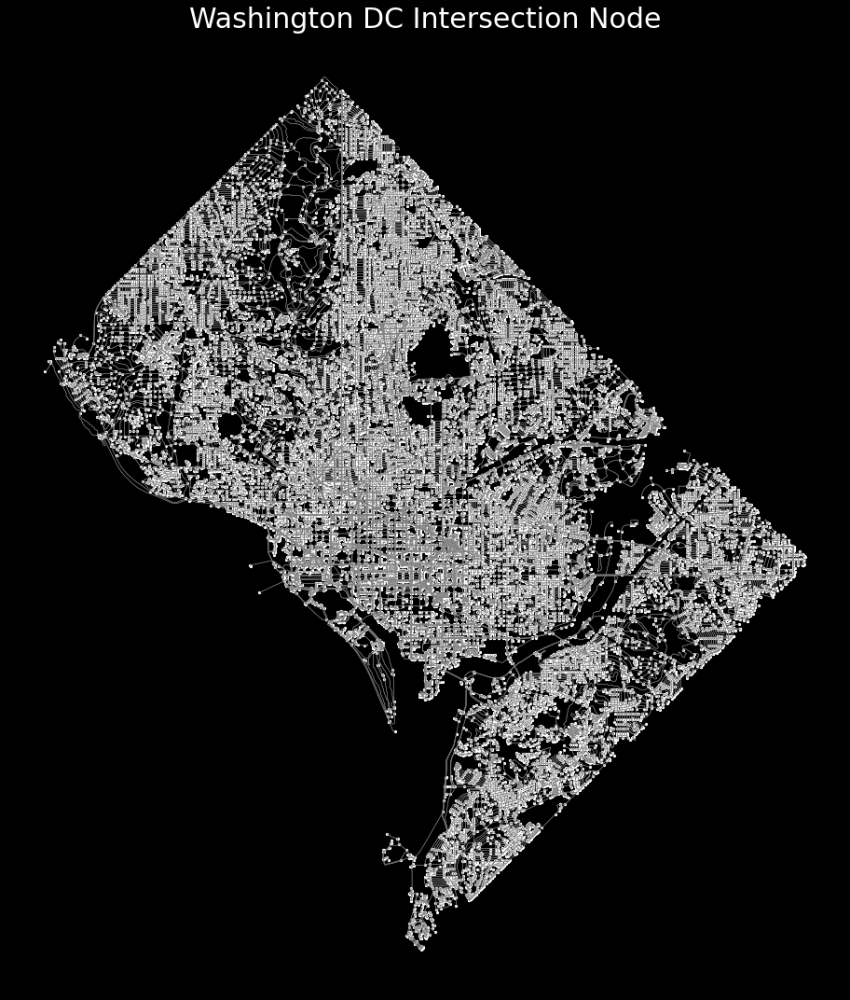

In [ ]:
# Define colors
edgecol = [0.5,0.5,0.5]
nodecol = 'white'
linewidth = 0.5
markersize = 5

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot original graph
edges.plot(ax=ax, color=edgecol, linewidth=linewidth)
nodes.plot(ax=ax, color=nodecol, markersize=markersize)

plt.title("Washington DC Intersection Node", fontsize=30, color="white")


# Tight layout 
plt.tight_layout()
# Save
plt.savefig('/content/DC_Node.png', facecolor=fig.get_facecolor())

In [ ]:
# Print info
print(
    'number of nodes:\n\noriginal graph: '+str(len(nodes))
)

number of nodes:

original graph: 48691


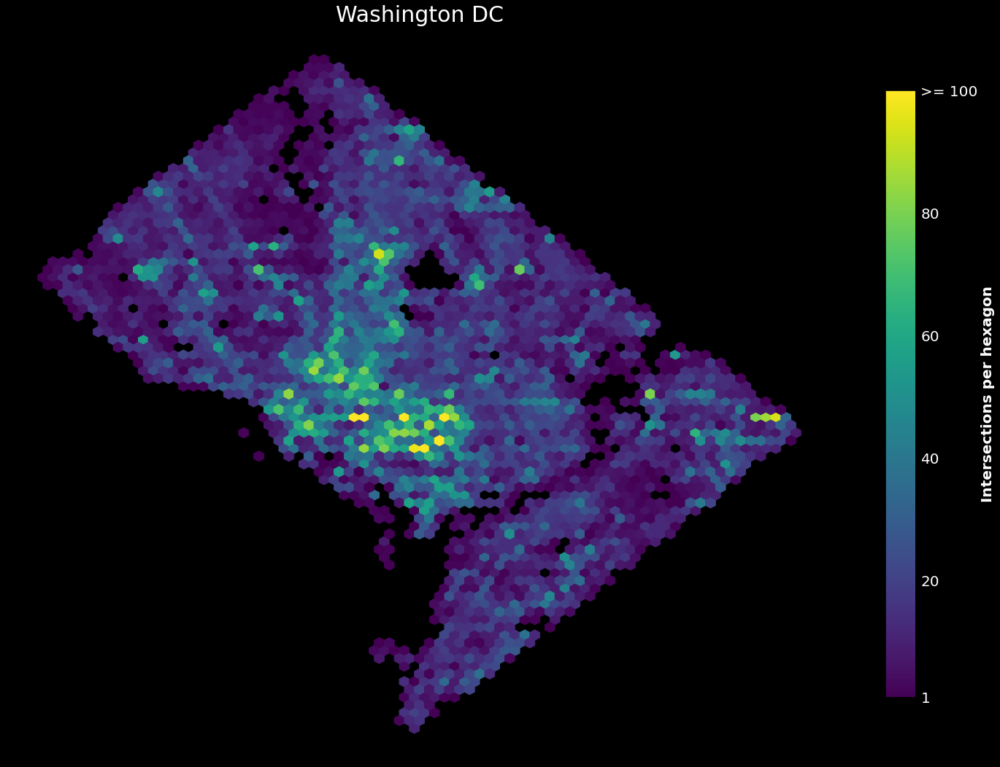

In [ ]:
# Set all text color to white
COLOR = 'white'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot as hexbins
hb = ax.hexbin(
    x=nodes['x'],
    y=nodes['y'],
    gridsize=75,
    cmap='viridis',
    mincnt=1,
    vmax=100,
)

plt.title("Washington DC", fontsize=30, color="white")
# Colorbar
cb = plt.colorbar(hb, ax=ax, shrink=0.8, ticks=[1, 20, 40, 60, 80, 100])
cb.ax.tick_params(color='none', labelsize=20)
cb.ax.set_yticklabels(['1', '20', '40', '60', '80', '>= 100'])
cb.set_label('Intersections per hexagon', fontsize=20, fontweight='bold')

# Tight layout
plt.tight_layout()

fig.savefig('/content/DC_Hex.png', facecolor=fig.get_facecolor())


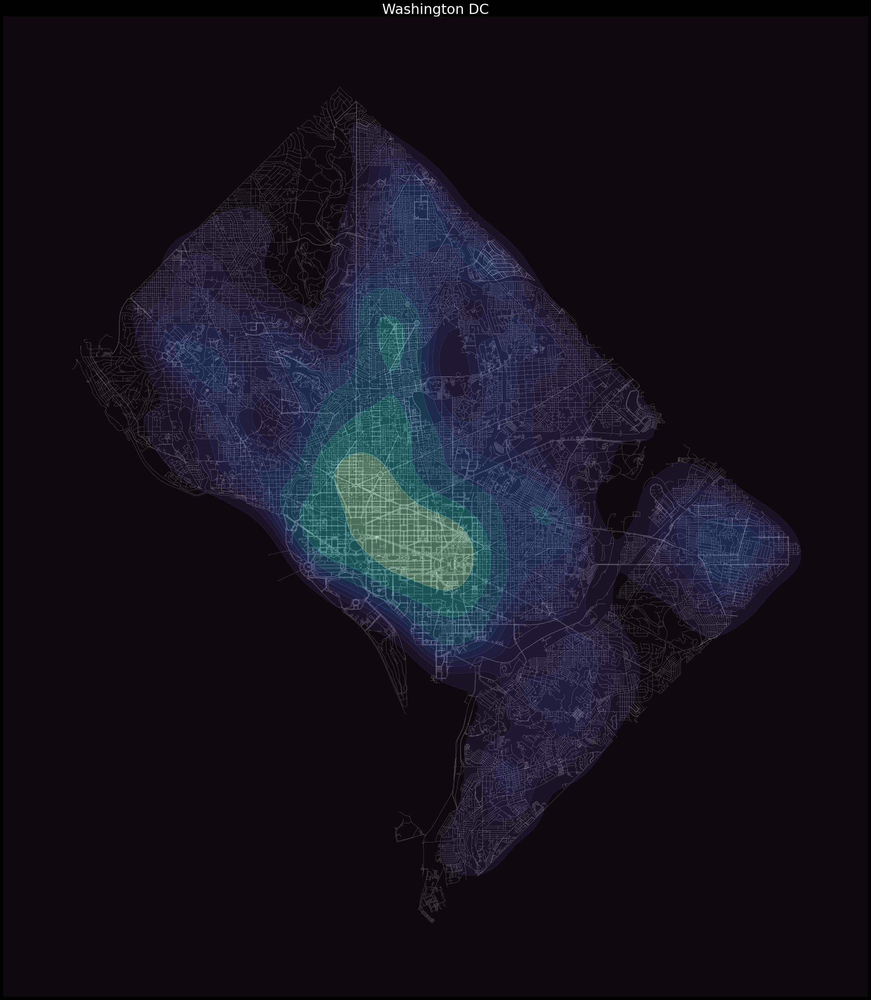

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(30,30))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot streets underneath
edges.plot(ax=ax, color=[1,1,1], linewidth=0.2, zorder= 0)

# Plot KDE on top
sns.kdeplot(
    ax=ax,
    data=nodes,
    x='x', y='y',
    hue=None,
    fill=True,
    cmap='mako',
    thresh=0,
    levels=10,
    alpha=0.5,
    zorder=10
)

plt.title("Washington DC", fontsize=30, color="white")
# Tight layout
plt.tight_layout()

# Save
plt.savefig('/content/DC_intersection_kde.png', bbox_inches='tight', facecolor=fig.get_facecolor())

In [ ]:
# Select city and crs
seattle = 'seattle, usa'
crs_seattle = 4326

In [ ]:
# Get graph by geocoding
graph_seattle = ox.graph_from_place(seattle, network_type="walk")

# Project graph
graph_seattle = ox.projection.project_graph(graph_seattle, to_crs=crs_seattle)

In [ ]:
# Simplify to get real intersections only
# (consolidate nodes within a distance from eachother)
graph_simplified_seattle = ox.simplification.consolidate_intersections(
    # Graph to simplify
    graph_seattle,
    # buffer around each node (project the graph beforehand)
    tolerance=5,
    # Get result as graph (False to get nodes only as gdf)
    rebuild_graph=True,
    # no dead ends
    dead_ends=False,
    # Reconnect (False to get intersections only)
    reconnect_edges=True
)

/usr/local/lib/python3.7/dist-packages/osmnx/simplification.py:424: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/usr/local/lib/python3.7/dist-packages/osmnx/simplification.py:472: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = node_clusters.centroid


In [ ]:
# everything to gdfs
nodes_seattle, edges = ox.graph_to_gdfs(graph_seattle)
nodes_s_seattle, edges_s = ox.graph_to_gdfs(graph_simplified_seattle)

In [ ]:
nodes_seattle.head()
nodes_seattle.to_csv('/content/nodes_seattle.csv') 

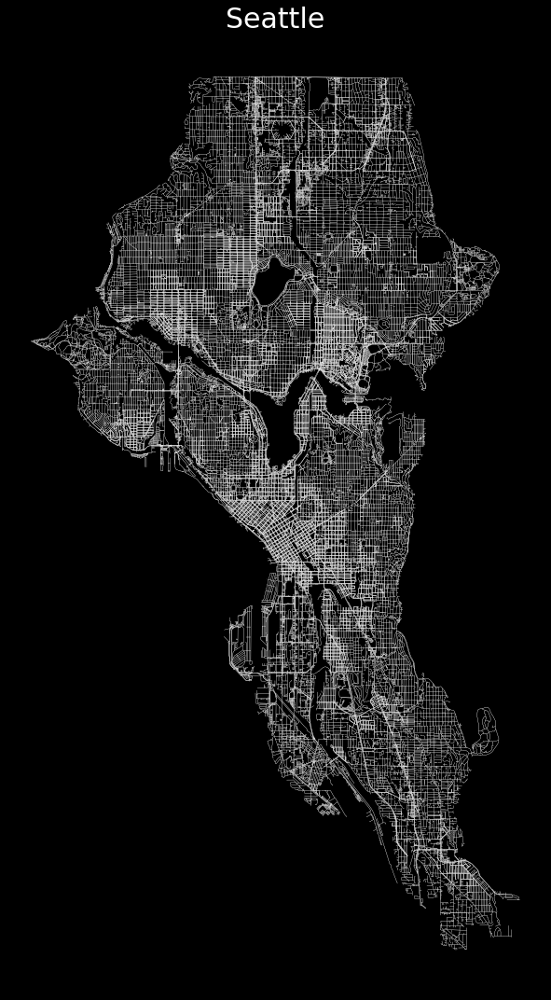

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot data
edges.plot(
    ax=ax,
    color='white',
    linewidth=0.2
)
plt.title("Seattle", fontsize=30, color="white")

# Tight layout
plt.tight_layout()
# Save
fig.savefig('/content/Seattle_Street.png', facecolor=fig.get_facecolor())

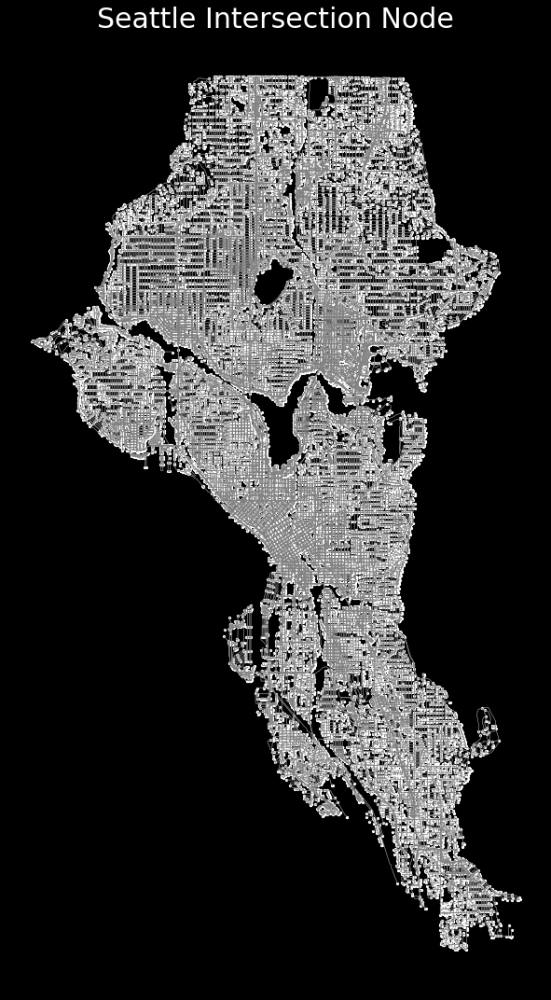

In [ ]:
# Define colors
edgecol = [0.5,0.5,0.5]
nodecol = 'white'
linewidth = 0.5
markersize = 5

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot original graph
edges.plot(ax=ax, color=edgecol, linewidth=linewidth)
nodes.plot(ax=ax, color=nodecol, markersize=markersize)

plt.title("Seattle Intersection Node", fontsize=30, color="white")


# Tight layout 
plt.tight_layout()
# Save
plt.savefig('/content/Seattle_Node.png', facecolor=fig.get_facecolor())

In [ ]:
# Print info
print(
    'number of nodes:\n\noriginal graph: '+str(len(nodes))
)

number of nodes:

original graph: 87727


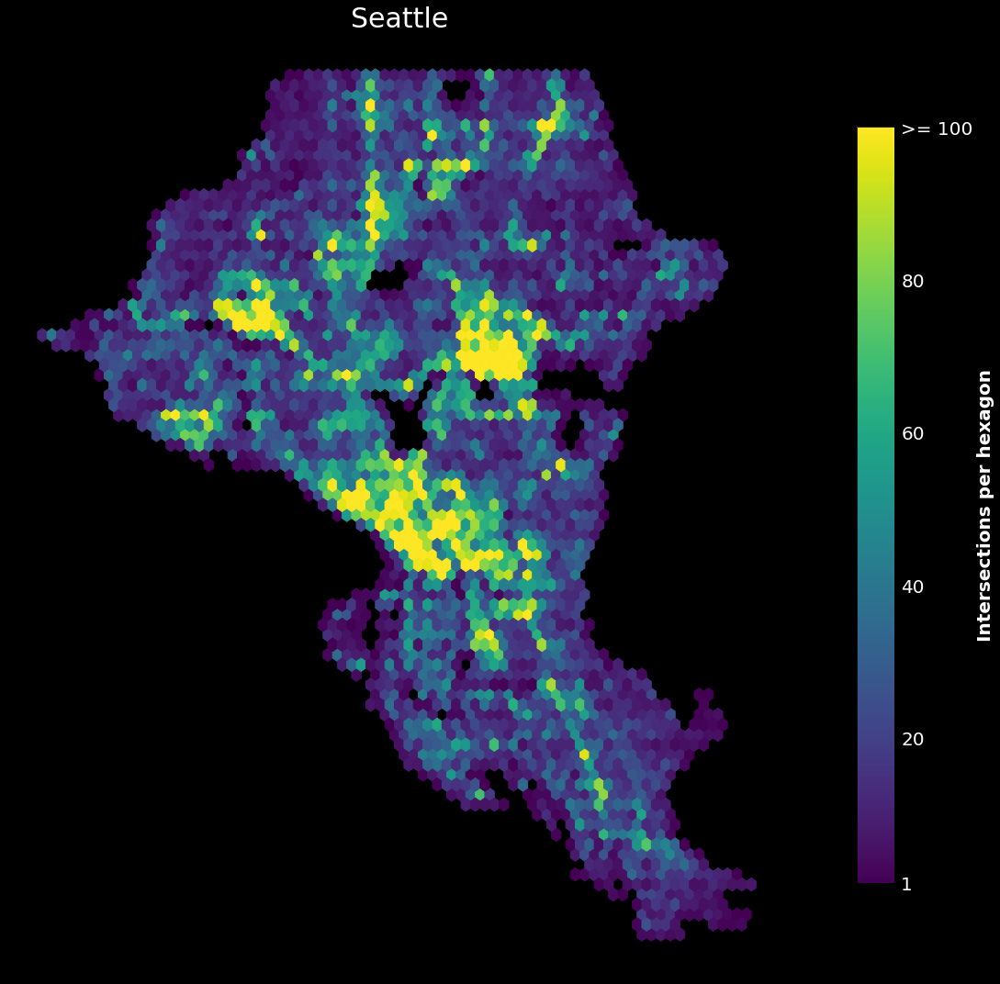

In [ ]:
# Set all text color to white
COLOR = 'white'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot as hexbins
hb = ax.hexbin(
    x=nodes['x'],
    y=nodes['y'],
    gridsize=75,
    cmap='viridis',
    mincnt=1,
    vmax=100,
)

plt.title("Seattle", fontsize=30, color="white")
# Colorbar
cb = plt.colorbar(hb, ax=ax, shrink=0.8, ticks=[1, 20, 40, 60, 80, 100])
cb.ax.tick_params(color='none', labelsize=20)
cb.ax.set_yticklabels(['1', '20', '40', '60', '80', '>= 100'])
cb.set_label('Intersections per hexagon', fontsize=20, fontweight='bold')

# Tight layout
plt.tight_layout()

fig.savefig('/content/Seattle_Hex.png', facecolor=fig.get_facecolor())


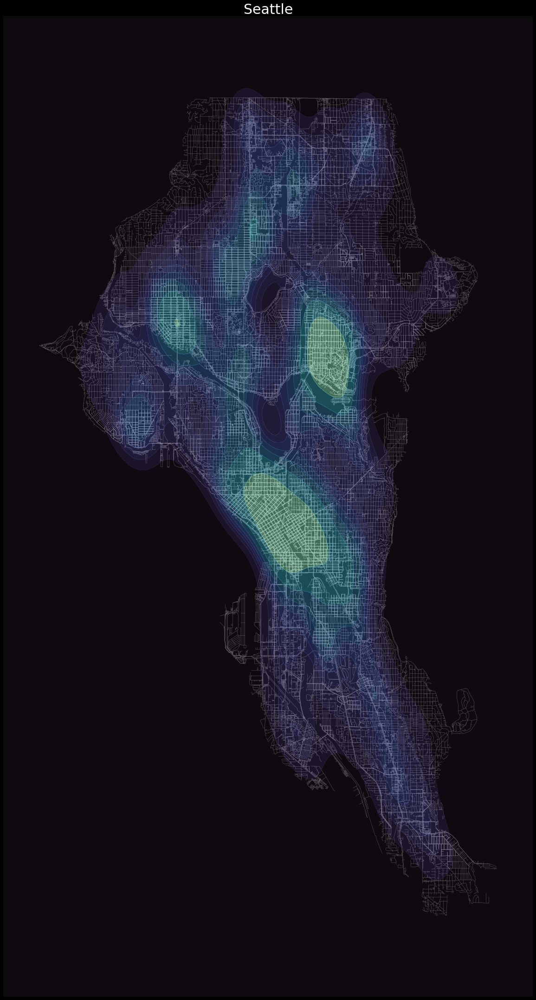

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(30,30))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot streets underneath
edges.plot(ax=ax, color=[1,1,1], linewidth=0.2, zorder= 0)

# Plot KDE on top
sns.kdeplot(
    ax=ax,
    data=nodes,
    x='x', y='y',
    hue=None,
    fill=True,
    cmap='mako',
    thresh=0,
    levels=10,
    alpha=0.5,
    zorder=10
)

plt.title("Seattle", fontsize=30, color="white")
# Tight layout
plt.tight_layout()

# Save
plt.savefig('/content/Seattle_intersection_kde.png', bbox_inches='tight', facecolor=fig.get_facecolor())

In [ ]:
# Select city and crs
chicago = 'chicago, usa'
crs_chicago = 6454

In [ ]:
# Get graph by geocoding
graph_chicago = ox.graph_from_place(chicago, network_type="walk")

# Project graph
graph_chicago = ox.projection.project_graph(graph_chicago, to_crs=crs_chicago)

In [ ]:
# Simplify to get real intersections only
# (consolidate nodes within a distance from eachother)
graph_simplified_chicago = ox.simplification.consolidate_intersections(
    # Graph to simplify
    graph_chicago,
    # buffer around each node (project the graph beforehand)
    tolerance=5,
    # Get result as graph (False to get nodes only as gdf)
    rebuild_graph=True,
    # no dead ends
    dead_ends=False,
    # Reconnect (False to get intersections only)
    reconnect_edges=True
)

In [ ]:
# everything to gdfs
nodes_chicago, edges = ox.graph_to_gdfs(graph_chicago)
nodes_s_chicago, edges_s = ox.graph_to_gdfs(graph_simplified_chicago)

In [ ]:
nodes_chicago.head()
nodes_chicago.to_csv('/content/nodes_chicago.csv') 

In [ ]:
nodes.head(5)

,y,x,street_count,lon,lat,ref,highway,geometry
osmid,,,,,,,,
20217237,579881.314258,358225.901021,1,-87.631768,41.887824,NaN,NaN,POINT (358225.901 579881.314)
8694826358,579883.524400,358225.866352,3,-87.631768,41.887844,NaN,NaN,POINT (358225.866 579883.524)
20217442,578915.359388,357734.641673,1,-87.637781,41.879164,Shoreline Water Taxi,NaN,POINT (357734.642 578915.359)
6423774545,578916.019849,357740.754258,3,-87.637707,41.879169,NaN,NaN,POINT (357740.754 578916.020)
26098097,576837.757625,359425.636569,1,-87.617619,41.860334,NaN,traffic_signals,POINT (359425.637 576837.758)


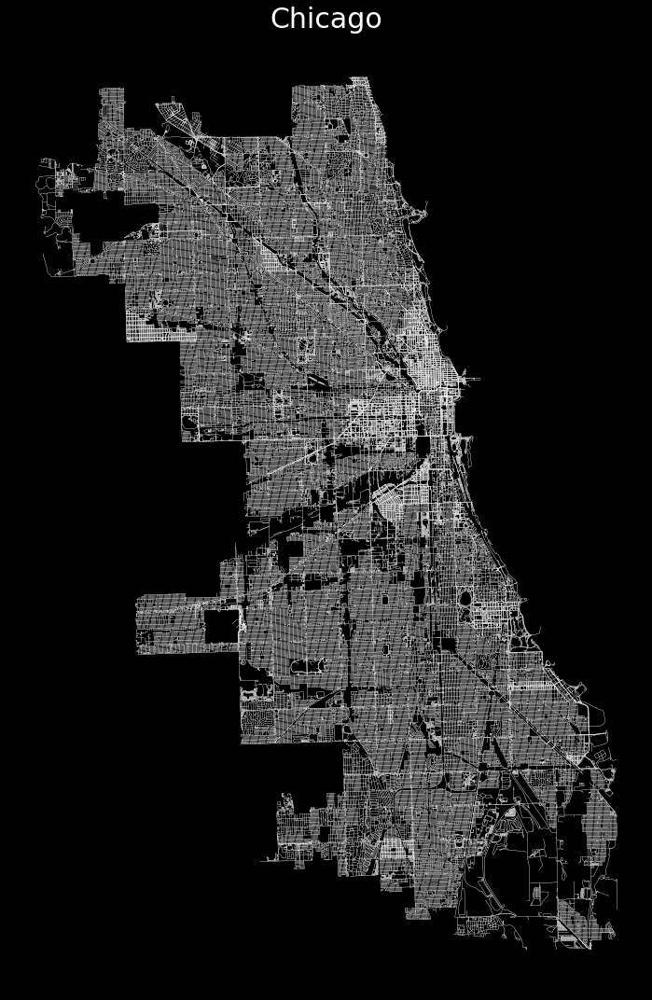

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot data
edges.plot(
    ax=ax,
    color='white',
    linewidth=0.2
)
plt.title("Chicago", fontsize=30, color="white")

# Tight layout
plt.tight_layout()
# Save
fig.savefig('/content/Chicago_Street.png', facecolor=fig.get_facecolor())

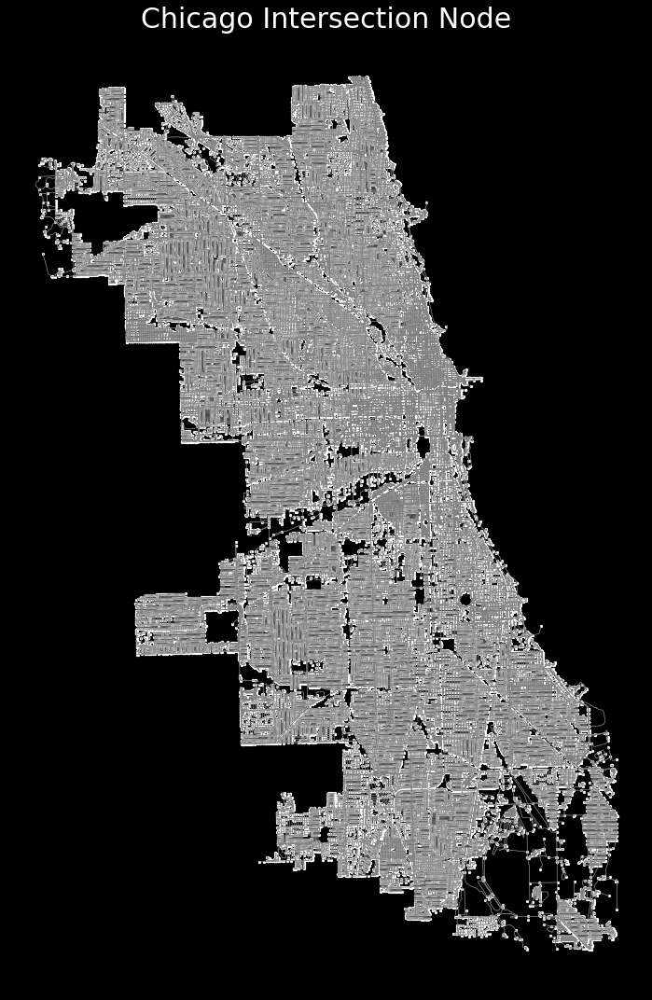

In [ ]:
# Define colors
edgecol = [0.5,0.5,0.5]
nodecol = 'white'
linewidth = 0.5
markersize = 5

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot original graph
edges.plot(ax=ax, color=edgecol, linewidth=linewidth)
nodes.plot(ax=ax, color=nodecol, markersize=markersize)

plt.title("Chicago Intersection Node", fontsize=30, color="white")


# Tight layout 
plt.tight_layout()
# Save
plt.savefig('/content/Chicago_Node.png', facecolor=fig.get_facecolor())

In [ ]:
# Print info
print(
    'number of nodes:\n\noriginal graph: '+str(len(nodes))
)

number of nodes:

original graph: 138447


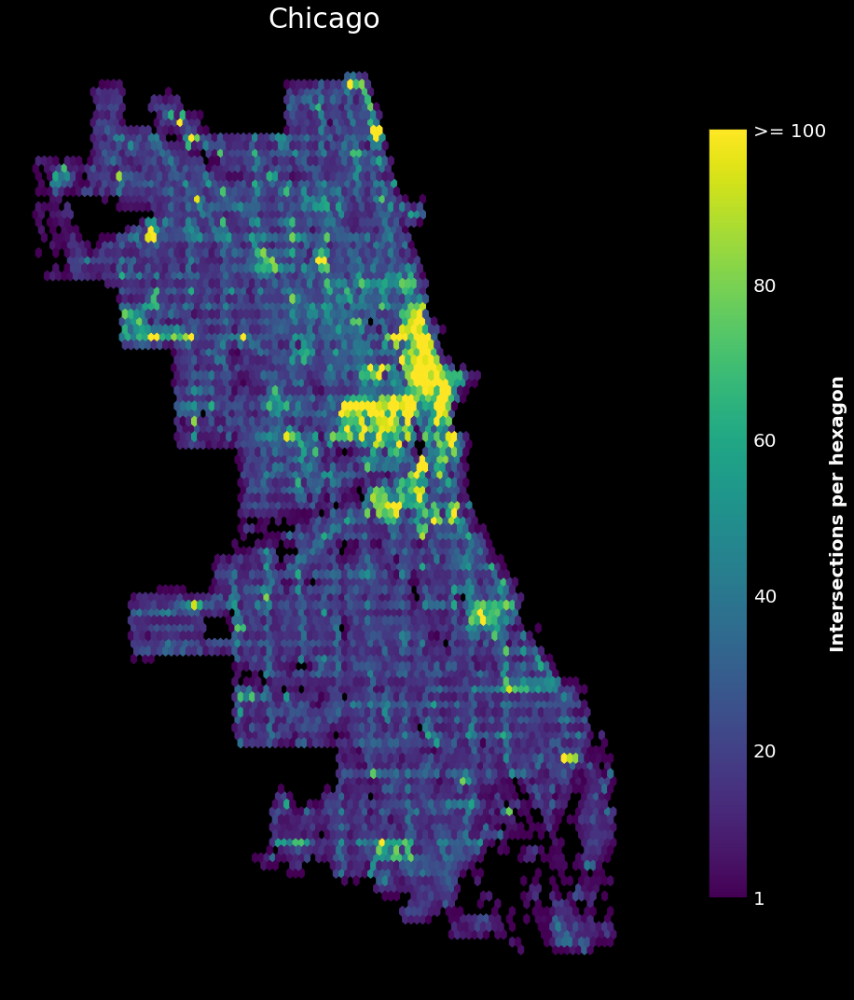

In [ ]:
# Set all text color to white
COLOR = 'white'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

# Setup plot
fig, ax = plt.subplots(figsize=(20,15))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot as hexbins
hb = ax.hexbin(
    x=nodes['x'],
    y=nodes['y'],
    gridsize=100,
    cmap='viridis',
    mincnt=1,
    vmax=100,
)

plt.title("Chicago", fontsize=30, color="white")
# Colorbar
cb = plt.colorbar(hb, ax=ax, shrink=0.8, ticks=[1, 20, 40, 60, 80, 100])
cb.ax.tick_params(color='none', labelsize=20)
cb.ax.set_yticklabels(['1', '20', '40', '60', '80', '>= 100'])
cb.set_label('Intersections per hexagon', fontsize=20, fontweight='bold')

# Tight layout
plt.tight_layout()

fig.savefig('/content/Chicago_Hex.png', facecolor=fig.get_facecolor())

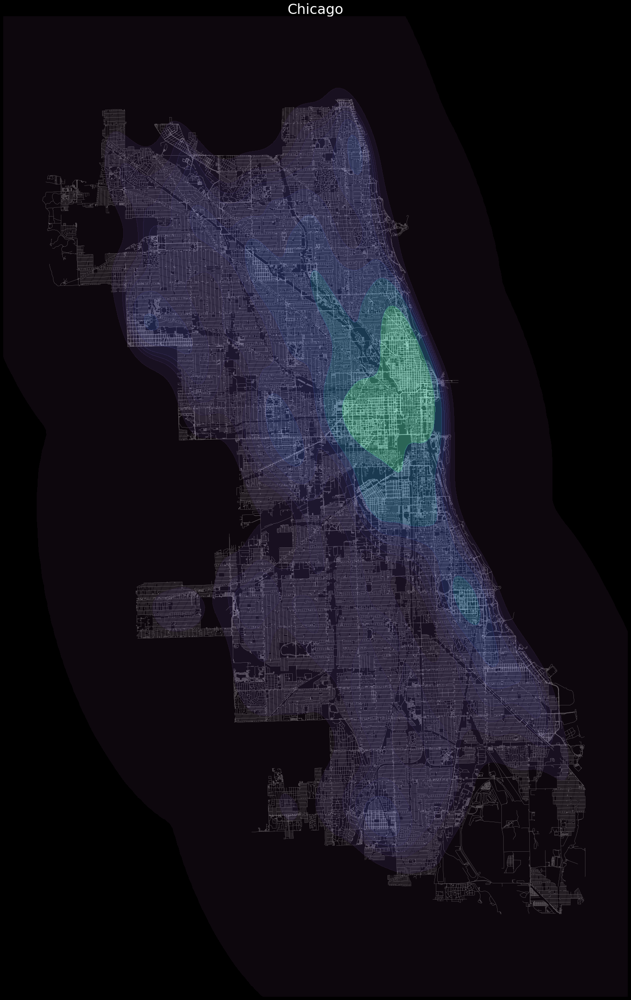

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(30,30))
ax.set_axis_off()
ax.set_aspect('equal')
fig.set_facecolor('black')

# Plot streets underneath
edges.plot(ax=ax, color=[1,1,1], linewidth=0.2, zorder= 0)

# Plot KDE on top
sns.kdeplot(
    ax=ax,
    data=nodes,
    x='x', y='y',
    hue=None,
    fill=True,
    cmap='mako',
    thresh=0,
    levels=10,
    alpha=0.5,
    zorder=10
)

plt.title("Chicago", fontsize=30, color="white")
# Tight layout
plt.tight_layout()

# Save
plt.savefig('/content/Chicago_intersection_kde.png', bbox_inches='tight', facecolor=fig.get_facecolor())